In [ ]:
!pip install ultralytics

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.8/993.8 kB 24.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 76.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 64.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 47.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 85.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [ ]:
# Create a new dataset.yaml file with correct paths
import yaml

# Define the data directory
DATA_DIR = '/content/drive/MyDrive/yolo'

# Define the correct dataset configuration
dataset_config = {
    'path': DATA_DIR,  # Root path
    'train': 'images/train/',  # Train images (relative to 'path')
    'val': 'images/val/',      # Val images (relative to 'path')
    'test': 'images/test/',    # Test images (relative to 'path')
    'names': {                 # Class names
        0: 'Handgun',
        1: 'Knife',
        2: 'Short_rifle'
    }
}

# Save the configuration to a new YAML file
with open('/content/dataset.yaml', 'w') as file:
    yaml.dump(dataset_config, file)

print("\nNew dataset configuration:")
!cat /content/dataset.yaml

# Verify the image paths exist
print("\nVerifying paths:")
!ls -la "{DATA_DIR}/images/train" 2>/dev/null || echo "Train images directory not found"
!ls -la "{DATA_DIR}/images/val" 2>/dev/null || echo "Val images directory not found"
!ls -la "{DATA_DIR}/images/test" 2>/dev/null || echo "Test images directory not found"

# Load pretrained YOLO model
from ultralytics import YOLO
model = YOLO('yolo11n.pt')

# Create output directories
!mkdir -p /content/drive/MyDrive/yolo_output

# Train with the corrected config
model.train(
    data="/content/dataset.yaml",
    epochs=50,
    imgsz=320,
    batch=64,
    patience=10,
    optimizer='AdamW',
    device=0,  # Use GPU
    project='/content/drive/MyDrive/yolo_output',
    name='train_colab',
    exist_ok=True
)

# Evaluate performance
metrics = model.val()
print(metrics)

# Save the trained model to Google Drive
!cp -r /content/runs/detect/train_colab /content/drive/MyDrive/yolo_output/

total 9
-rw------- 1 root root  172 Apr  5 21:17 dataset.yaml
drwx------ 3 root root 4096 Apr  5 22:15 images
drwx------ 2 root root 4096 Apr  5 22:15 labels
total 12
drwx------ 2 root root 4096 Apr  5 22:15 test
drwx------ 2 root root 4096 Apr  5 22:15 train
drwx------ 2 root root 4096 Apr  5 22:15 val
total 978
drwx------ 2 root root   4096 Apr  5 22:15 test
drwx------ 2 root root   4096 Apr  5 22:15 train
-rw------- 1 root root 849111 Apr  5 21:19 train.cache
drwx------ 2 root root   4096 Apr  5 22:15 val
-rw------- 1 root root 139471 Apr  5 21:19 val.cache

New dataset configuration:
names:
  0: Handgun
  1: Knife
  2: Short_rifle
path: /content/drive/MyDrive/yolo
test: images/test/
train: images/train/
val: images/val/

Verifying paths:
total 967709
-rw------- 1 root root 296085 Apr  5 21:17 Cam1-From09-23-00To10-03-25_Segment_0_x264_frame_100.jpg
-rw------- 1 root root 273636 Apr  5 21:09 Cam1-From09-23-00To10-03-25_Segment_0_x264_frame_101.jpg
-rw------- 1 root root 282443 Apr  

100%|██████████| 755k/755k [00:00<00:00, 43.5MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/drive/MyDrive/yolo/labels/train... 3510 images, 2042 backgrounds, 0 corrupt: 100%|██████████| 3510/3510 [14:24<00:00,  4.06it/s]


train: New cache created: /content/drive/MyDrive/yolo/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/yolo/labels/val... 602 images, 442 backgrounds, 0 corrupt: 100%|██████████| 602/602 [01:31<00:00,  6.57it/s]


val: New cache created: /content/drive/MyDrive/yolo/labels/val.cache
Plotting labels to /content/drive/MyDrive/yolo_output/train_colab/labels.jpg... 
optimizer: AdamW(lr=0.01, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/yolo_output/train_colab
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.23G      4.305      8.763      1.405         45        320: 100%|██████████| 55/55 [01:11<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:08<00:00,  1.79s/it]


                   all        602        284   0.000987     0.0374   0.000513   5.24e-05

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.34G       4.24      3.613      1.248         81        320: 100%|██████████| 55/55 [01:13<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.53s/it]


                   all        602        284    0.00106    0.00625   0.000315    0.00012

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.35G      4.182       3.54      1.217         63        320: 100%|██████████| 55/55 [01:12<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.10s/it]

                   all        602        284          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.36G       4.18      3.506      1.199         67        320: 100%|██████████| 55/55 [01:14<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.22s/it]

                   all        602        284      0.338     0.0161      0.001    0.00015



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.38G      4.061      3.429      1.188         81        320: 100%|██████████| 55/55 [01:13<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.37s/it]

                   all        602        284      0.345    0.00541    0.00158   0.000425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.38G      3.941       3.36      1.154         48        320: 100%|██████████| 55/55 [01:11<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.30s/it]

                   all        602        284      0.367     0.0269    0.00868     0.0029



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.39G      3.862      3.175      1.143         83        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.24s/it]

                   all        602        284      0.372     0.0295     0.0112    0.00254



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.39G      3.811      3.199      1.129         61        320: 100%|██████████| 55/55 [01:12<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.25s/it]

                   all        602        284      0.358     0.0286    0.00353   0.000637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.41G      3.812      3.152      1.136         63        320: 100%|██████████| 55/55 [01:10<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.28s/it]

                   all        602        284      0.445     0.0735     0.0326    0.00776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.41G      3.792      3.086      1.144         60        320: 100%|██████████| 55/55 [01:13<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.18s/it]

                   all        602        284     0.0532      0.044     0.0314    0.00765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.41G      3.682      2.981      1.108         55        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.31s/it]

                   all        602        284      0.463      0.068     0.0449     0.0121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.41G       3.64      2.931      1.096         41        320: 100%|██████████| 55/55 [01:13<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.14s/it]


                   all        602        284      0.426     0.0393     0.0242    0.00533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.41G      3.686      2.937      1.099         53        320: 100%|██████████| 55/55 [01:12<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.50s/it]

                   all        602        284      0.453     0.0887     0.0377    0.00972



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.41G      3.585      2.827      1.092         93        320: 100%|██████████| 55/55 [01:13<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.18s/it]

                   all        602        284      0.489     0.0963     0.0694     0.0203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.41G      3.579      2.845      1.103         49        320: 100%|██████████| 55/55 [01:13<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.03s/it]

                   all        602        284       0.44     0.0837     0.0402    0.00956



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.41G      3.553      2.803      1.078         74        320: 100%|██████████| 55/55 [01:12<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.56s/it]

                   all        602        284      0.127     0.0938     0.0602     0.0143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.41G      3.517      2.703      1.078         56        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.26s/it]

                   all        602        284      0.489      0.109     0.0855     0.0232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.41G      3.508      2.729      1.069         66        320: 100%|██████████| 55/55 [01:13<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.18s/it]

                   all        602        284     0.0237      0.167     0.0295    0.00949



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.41G      3.432       2.66      1.084         67        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.48s/it]


                   all        602        284      0.531     0.0909     0.0541     0.0122

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.41G      3.387      2.655      1.043         59        320: 100%|██████████| 55/55 [01:12<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.17s/it]

                   all        602        284      0.497      0.101     0.0758     0.0233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.41G       3.45      2.696      1.053         92        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.44s/it]

                   all        602        284      0.497     0.0698     0.0727     0.0242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.41G      3.335      2.605      1.058         89        320: 100%|██████████| 55/55 [01:13<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.49s/it]

                   all        602        284      0.469      0.112     0.0949     0.0324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.41G      3.361      2.539      1.046         73        320: 100%|██████████| 55/55 [01:13<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.23s/it]

                   all        602        284      0.476     0.0867     0.0805      0.023



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.41G      3.324      2.526      1.055         54        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.53s/it]

                   all        602        284      0.557      0.118      0.104     0.0263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.41G      3.341      2.508      1.047         72        320: 100%|██████████| 55/55 [01:12<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.18s/it]

                   all        602        284       0.57      0.162      0.142     0.0342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.41G      3.254      2.446      1.031         63        320: 100%|██████████| 55/55 [01:13<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.23s/it]

                   all        602        284      0.521       0.17      0.123     0.0361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.41G      3.223      2.463      1.034         66        320: 100%|██████████| 55/55 [01:11<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.37s/it]

                   all        602        284      0.471      0.154      0.145     0.0467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.41G      3.229      2.382      1.042         75        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.18s/it]

                   all        602        284      0.541      0.152      0.133     0.0371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.41G      3.272      2.476      1.033         71        320: 100%|██████████| 55/55 [01:12<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.47s/it]

                   all        602        284      0.509      0.161      0.129      0.039



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.41G      3.231      2.373      1.047         60        320: 100%|██████████| 55/55 [01:13<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.27s/it]

                   all        602        284      0.559      0.156      0.129     0.0426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.41G      3.152      2.362      1.037         59        320: 100%|██████████| 55/55 [01:13<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.09s/it]

                   all        602        284      0.559      0.138      0.116     0.0327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.41G      3.146      2.319      1.017         58        320: 100%|██████████| 55/55 [01:12<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.55s/it]

                   all        602        284        0.5      0.205      0.163     0.0462



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.41G      3.195      2.327      1.016         56        320: 100%|██████████| 55/55 [01:11<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.08s/it]

                   all        602        284      0.496      0.254      0.194     0.0563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.41G      3.152      2.293      1.013         74        320: 100%|██████████| 55/55 [01:15<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.24s/it]

                   all        602        284      0.349      0.244      0.185     0.0564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.41G      3.169      2.292      1.029         94        320: 100%|██████████| 55/55 [01:13<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.49s/it]

                   all        602        284      0.274       0.18      0.147     0.0517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.41G      3.067      2.236      1.005         55        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.28s/it]

                   all        602        284      0.272      0.233      0.188     0.0664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.41G      3.072      2.253      1.009         61        320: 100%|██████████| 55/55 [01:10<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.14s/it]

                   all        602        284      0.566      0.229      0.203     0.0645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.41G      3.095       2.19      1.017         67        320: 100%|██████████| 55/55 [01:10<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.37s/it]

                   all        602        284      0.685      0.165      0.195     0.0599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.41G      3.026      2.192      1.003         78        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.06s/it]

                   all        602        284      0.599      0.238      0.225     0.0743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.41G      3.064      2.176      1.006         63        320: 100%|██████████| 55/55 [01:09<00:00,  1.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.49s/it]

                   all        602        284      0.357      0.246      0.221     0.0741


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.41G      2.922       2.21      1.019         40        320: 100%|██████████| 55/55 [01:14<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.14s/it]

                   all        602        284      0.405      0.214      0.212     0.0744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.41G      2.904      2.061      1.013         41        320: 100%|██████████| 55/55 [01:09<00:00,  1.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.44s/it]

                   all        602        284      0.422      0.275      0.252     0.0869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.41G       2.86      2.046      1.011         26        320: 100%|██████████| 55/55 [01:10<00:00,  1.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.08s/it]

                   all        602        284      0.378      0.294      0.245     0.0767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.41G      2.859      2.021      1.012         32        320: 100%|██████████| 55/55 [01:07<00:00,  1.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.43s/it]

                   all        602        284      0.378      0.296      0.253     0.0849



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.41G      2.837      1.978      1.017         39        320: 100%|██████████| 55/55 [01:14<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.45s/it]

                   all        602        284      0.477        0.3      0.277     0.0833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.41G      2.787       1.98     0.9983         42        320: 100%|██████████| 55/55 [01:11<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.28s/it]

                   all        602        284      0.652      0.216       0.23     0.0748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.41G      2.789       1.96      1.011         50        320: 100%|██████████| 55/55 [01:09<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.23s/it]

                   all        602        284      0.478      0.303      0.273     0.0891



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.41G      2.786      1.965      1.005         35        320: 100%|██████████| 55/55 [01:08<00:00,  1.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.49s/it]

                   all        602        284      0.456      0.288      0.286     0.0887



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.41G      2.786      1.943     0.9973         34        320: 100%|██████████| 55/55 [01:09<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:05<00:00,  1.13s/it]

                   all        602        284      0.375      0.291      0.269     0.0892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.41G      2.746      1.931      1.005         50        320: 100%|██████████| 55/55 [01:10<00:00,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:07<00:00,  1.56s/it]

                   all        602        284      0.402      0.284      0.266     0.0918



50 epochs completed in 1.116 hours.
Optimizer stripped from /content/drive/MyDrive/yolo_output/train_colab/weights/last.pt, 5.4MB
Optimizer stripped from /content/drive/MyDrive/yolo_output/train_colab/weights/best.pt, 5.4MB

Validating /content/drive/MyDrive/yolo_output/train_colab/weights/best.pt...
Ultralytics 8.3.102 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:09<00:00,  1.92s/it]


                   all        602        284      0.402      0.284      0.267     0.0919
               Handgun        120        185      0.282      0.286      0.223     0.0669
                 Knife         24         24      0.575      0.125      0.168     0.0558
           Short_rifle         65         75      0.351       0.44       0.41      0.153
Speed: 0.0ms preprocess, 0.6ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to /content/drive/MyDrive/yolo_output/train_colab
Ultralytics 8.3.102 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/drive/MyDrive/yolo/labels/val.cache... 602 images, 442 backgrounds, 0 corrupt: 100%|██████████| 602/602 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:14<00:00,  1.46s/it]


                   all        602        284      0.406      0.288      0.269     0.0906
               Handgun        120        185      0.284      0.286      0.221     0.0669
                 Knife         24         24      0.573      0.125      0.167     0.0557
           Short_rifle         65         75      0.362      0.453      0.418      0.149
Speed: 0.5ms preprocess, 1.7ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to /content/drive/MyDrive/yolo_output/train_colab
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x799ea81ccb90>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001, 

In [ ]:
# Load the TensorBoard extension
%load_ext tensorboard

# Point it to your training output directory
%tensorboard --logdir="/content/drive/MyDrive/yolo_output"

<IPython.core.display.Javascript object>

In [13]:
import yaml
import os
from ultralytics import YOLO
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Define the data directory
DATA_DIR = '/content/drive/MyDrive/yolo'

# Load the trained YOLO model
model = YOLO('/content/drive/MyDrive/yolo_output/train_colab/weights/best.pt')

# Fix the YAML file paths
yaml_path = f"{DATA_DIR}/dataset.yaml"

# Load the existing YAML
with open(yaml_path, 'r') as file:
    data_config = yaml.safe_load(file)

print("Original config:", data_config)

# Create a temporary fixed YAML with Colab paths
temp_yaml_path = f"{DATA_DIR}/temp_data.yaml"

# Update paths to match Colab structure
data_config['path'] = DATA_DIR  # Use the Colab path
# Use relative paths for train/val/test
data_config['train'] = './images/train/'
data_config['val'] = './images/val/'
data_config['test'] = './images/test/'

# Save the updated YAML
with open(temp_yaml_path, 'w') as file:
    yaml.dump(data_config, file)

print("Fixed config:", data_config)

# Now try running validation with the fixed YAML
try:
    print("\nRunning validation with fixed paths...")
    test_metrics = model.val(data=temp_yaml_path, split='test', imgsz=320, device=0)

    # If successful, extract and print metrics
    print("\n===== TEST METRICS =====")
    if hasattr(test_metrics, 'results_dict'):
        metrics_dict = test_metrics.results_dict
        metrics_df = pd.DataFrame(metrics_dict.items(), columns=['Metric', 'Value'])
        print(metrics_df)

        # Visualization code for metrics (omitted for brevity)
        # ...

except FileNotFoundError as e:
    print(f"\nPath error still exists: {e}")
    print("\nLet's try an alternative approach.")

    # Alternative: Use predict and calculate basic statistics
    print("\nRunning prediction instead...")
    results = model.predict(source=f"{DATA_DIR}/images/test", save=True,
                            imgsz=320, conf=0.25, device=0)

    # Count detections by class
    class_counts = {}
    for r in results:
        boxes = r.boxes
        for box in boxes:
            cls = int(box.cls[0].item())
            label = model.names[cls]
            if label in class_counts:
                class_counts[label] += 1
            else:
                class_counts[label] = 1

    print("\n===== DETECTION COUNTS =====")
    for cls, count in class_counts.items():
        print(f"{cls}: {count} detections")

    # Visualize detections by class
    if class_counts:
        plt.figure(figsize=(10, 6))
        sns.barplot(x=list(class_counts.keys()), y=list(class_counts.values()))
        plt.title('Detections by Class')
        plt.ylabel('Count')
        plt.xticks(rotation=45, ha='right')

        # Add counts on top of bars
        for i, (k, v) in enumerate(class_counts.items()):
            plt.text(i, v + 0.5, str(v), ha='center')

        plt.tight_layout()
        plt.savefig(f"{DATA_DIR}/detections_by_class.png", dpi=300)
        plt.show()

print("\nAnalysis complete!")

Original config: {'names': {0: 'Handgun', 1: 'Knife', 2: 'Short_rifle'}, 'path': '/Users/laurisoome/Desktop/hackathon-gun-detection/yolo', 'test': './images/test/', 'train': './images/train/', 'val': './images/val/'}
Fixed config: {'names': {0: 'Handgun', 1: 'Knife', 2: 'Short_rifle'}, 'path': '/content/drive/MyDrive/yolo', 'test': './images/test/', 'train': './images/train/', 'val': './images/val/'}

Running validation with fixed paths...
Ultralytics 8.3.102 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 16.0MB/s]
val: Scanning /content/drive/MyDrive/yolo/labels/test... 598 images, 459 backgrounds, 0 corrupt: 100%|██████████| 598/598 [00:52<00:00, 11.36it/s]


val: New cache created: /content/drive/MyDrive/yolo/labels/test.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:14<00:00,  2.71it/s]


                   all        598        246      0.677      0.222      0.235     0.0763
               Handgun        107        160      0.483      0.231       0.25     0.0818
                 Knife         24         24          1          0     0.0517     0.0126
           Short_rifle         51         62      0.548      0.435      0.403      0.134
Speed: 0.2ms preprocess, 2.5ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/val2

===== TEST METRICS =====
                 Metric     Value
0  metrics/precision(B)  0.676937
1     metrics/recall(B)  0.222245
2      metrics/mAP50(B)  0.234631
3   metrics/mAP50-95(B)  0.076283
4               fitness  0.092117

Analysis complete!


In [20]:
import fiftyone as fo
import os
import glob
from ultralytics import YOLO

# Define paths
DATA_DIR = '/content/drive/MyDrive/yolo'
TEST_DIR = f"{DATA_DIR}/images/test"
TEST_LABELS_DIR = f"{DATA_DIR}/labels/test"
MODEL_PATH = '/content/drive/MyDrive/yolo_output/train_colab/weights/best.pt'

# Load the model
model = YOLO(MODEL_PATH)
class_map = model.names  # {0: 'Handgun', 1: 'Knife', 2: 'Short_rifle'}

# Create a FiftyOne dataset
dataset = fo.Dataset("yolo_test_simple")

# Get all test images
test_images = glob.glob(os.path.join(TEST_DIR, "*.*"))
print(f"Found {len(test_images)} test images")

# Track how many samples have ground truth
ground_truth_count = 0

# Add images and predictions to the dataset
for img_path in test_images:
    # Get base filename without extension
    base_name = os.path.basename(img_path)
    name_without_ext = os.path.splitext(base_name)[0]

    # Create a FiftyOne sample for this image
    sample = fo.Sample(filepath=img_path)

    # Load ground truth if available
    label_path = os.path.join(TEST_LABELS_DIR, name_without_ext + ".txt")
    if os.path.exists(label_path):
        # YOLO format: class_id center_x center_y width height (normalized)
        gt_detections = []
        with open(label_path, 'r') as f:
            for line in f:
                values = line.strip().split()
                if len(values) == 5:
                    class_id, x_center, y_center, width, height = map(float, values)
                    # Convert from YOLO format to FiftyOne format
                    # YOLO: center_x, center_y, width, height (normalized)
                    # FiftyOne: top-left x, top-left y, width, height (normalized)
                    x = x_center - (width / 2)
                    y = y_center - (height / 2)

                    gt_detection = fo.Detection(
                        label=class_map[int(class_id)],
                        bounding_box=[x, y, width, height]
                    )
                    gt_detections.append(gt_detection)

        sample["ground_truth"] = fo.Detections(detections=gt_detections)
        ground_truth_count += 1

    # Run YOLO prediction
    results = model(img_path, conf=0.25)[0]

    # Create detections field
    pred_detections = []

    if results.boxes is not None and len(results.boxes) > 0:
        # Get boxes, classes and confidence scores
        boxes = results.boxes.xyxy.cpu().numpy()
        cls_ids = results.boxes.cls.cpu().numpy().astype(int)
        confs = results.boxes.conf.cpu().numpy()

        # Get image dimensions for normalization
        img_height, img_width = results.orig_img.shape[:2]

        # Create detections
        for box, cls_id, conf in zip(boxes, cls_ids, confs):
            # Convert to normalized coordinates: [top-left-x, top-left-y, width, height]
            x1, y1, x2, y2 = box
            width = (x2 - x1) / img_width
            height = (y2 - y1) / img_height
            x = x1 / img_width
            y = y1 / img_height

            # Add detection
            detection = fo.Detection(
                label=class_map[cls_id],
                bounding_box=[x, y, width, height],
                confidence=float(conf)
            )
            pred_detections.append(detection)

    # Add detections to sample
    sample["predictions"] = fo.Detections(detections=pred_detections)

    # Add the sample to the dataset
    dataset.add_sample(sample)

print(f"Added {len(dataset)} samples to the dataset")
print(f"Found {ground_truth_count} samples with ground truth")

# Simple evaluation without complex filtering
if ground_truth_count > 0:
    try:
        # Add evaluation
        results = dataset.evaluate_detections(
            "predictions",
            "ground_truth",
            method="coco",
            classes=list(class_map.values()),
            eval_key="eval"
        )

        # Print evaluation results
        print("\nDetection Evaluation Results:")
        metrics = results.metrics()
        print(f"Available metrics: {list(metrics.keys())}")

        # Print overall metrics
        print("\nOverall metrics:")
        for metric, value in metrics.items():
            if isinstance(value, (int, float)):
                print(f"{metric}: {value:.4f}")

    except Exception as e:
        print(f"Error in evaluation: {e}")

# Create very basic views without complex filtering
# Simply get all samples with predictions
samples_with_predictions = dataset.exists("predictions")
print(f"Samples with predictions: {len(samples_with_predictions)}")

# Get samples with ground truth
samples_with_gt = dataset.exists("ground_truth")
print(f"Samples with ground truth: {len(samples_with_gt)}")

# Launch app and view the results
session = fo.launch_app(dataset)

# Show all samples, sorted by confidence
print("\nShowing all results sorted by confidence")
default_view = dataset.sort_by("predictions.detections.confidence", reverse=True)
session.view = default_view

# Print simple instructions
print("\nUse these commands to explore the results:")
print("session.view = dataset  # Show all samples")
print("session.view = default_view  # Show all samples sorted by confidence")

Found 598 test images

image 1/1 /content/drive/MyDrive/yolo/images/test/Cam5-From09-30-04To09-30-42-Guns_x264_frame_65.jpg: 192x320 (no detections), 9.9ms
Speed: 0.9ms preprocess, 9.9ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 320)

image 1/1 /content/drive/MyDrive/yolo/images/test/Cam7-From09-05-50To10-09-24_Segment_8_x264_frame_2986.jpg: 192x320 (no detections), 10.8ms
Speed: 1.0ms preprocess, 10.8ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 320)

image 1/1 /content/drive/MyDrive/yolo/images/test/Cam7-From09-05-50To10-09-24_Segment_8_x264_frame_3367.jpg: 192x320 (no detections), 9.2ms
Speed: 0.8ms preprocess, 9.2ms inference, 0.6ms postprocess per image at shape (1, 3, 192, 320)

image 1/1 /content/drive/MyDrive/yolo/images/test/Cam7-From09-05-50To10-09-24_Segment_8_x264_frame_2692.jpg: 192x320 (no detections), 8.9ms
Speed: 0.8ms preprocess, 8.9ms inference, 0.5ms postprocess per image at shape (1, 3, 192, 320)

image 1/1 /content/drive/MyDrive/y

INFO:fiftyone.utils.eval.detection:Evaluating detections...


 100% |█████████████████| 598/598 [595.6ms elapsed, 0s remaining, 1.0K samples/s]      


INFO:eta.core.utils: 100% |█████████████████| 598/598 [595.6ms elapsed, 0s remaining, 1.0K samples/s]      



Detection Evaluation Results:
Available metrics: ['accuracy', 'precision', 'recall', 'fscore', 'support']

Overall metrics:
accuracy: 0.1774
precision: 0.7121
recall: 0.1911
fscore: 0.3013
support: 246.0000
Samples with predictions: 598
Samples with ground truth: 598



Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v1.4.1

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Discord community 🚀🚀🚀
|  https://community.voxel51.com/
|



INFO:fiftyone.core.session.session:
Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v1.4.1

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Discord community 🚀🚀🚀
|  https://community.voxel51.com/
|




Showing all results sorted by confidence



Use these commands to explore the results:
session.view = dataset  # Show all samples
session.view = default_view  # Show all samples sorted by confidence


Plotting class distribution...


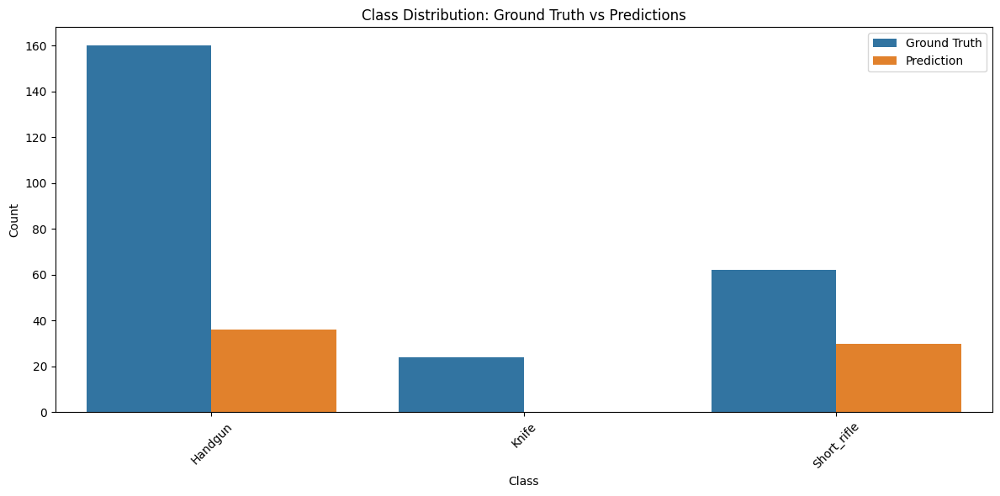


Simple Recall by Class (Predictions/Ground Truth):
Handgun: 0.23 (36/160)
Knife: 0.00 (0/24)
Short_rifle: 0.48 (30/62)

Plotting confidence distribution...


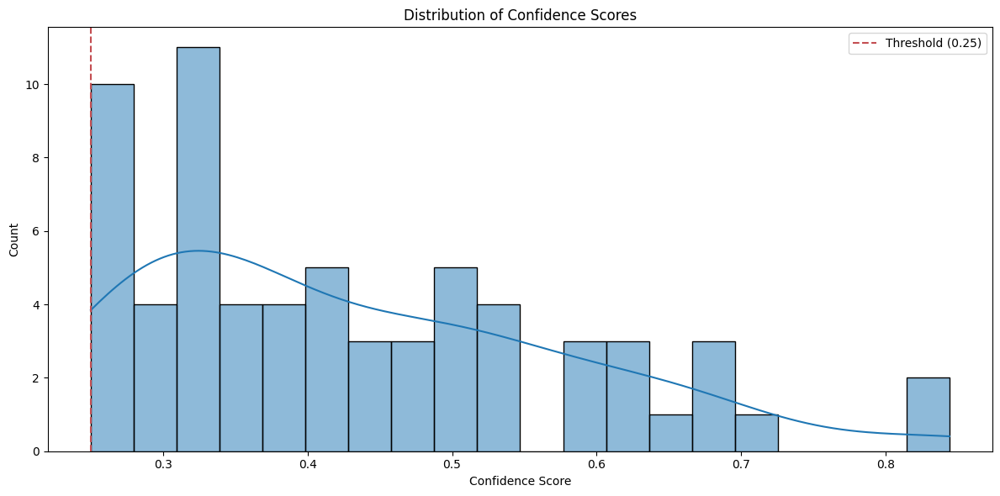

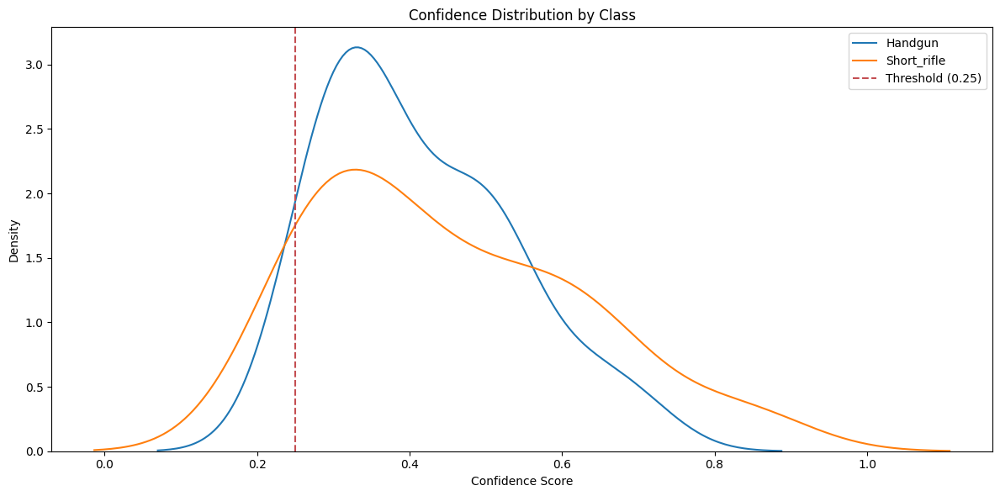


Average Confidence by Class:
Handgun: 0.4131 (from 36 detections)
Short_rifle: 0.4514 (from 30 detections)

Plotting precision-recall curve...


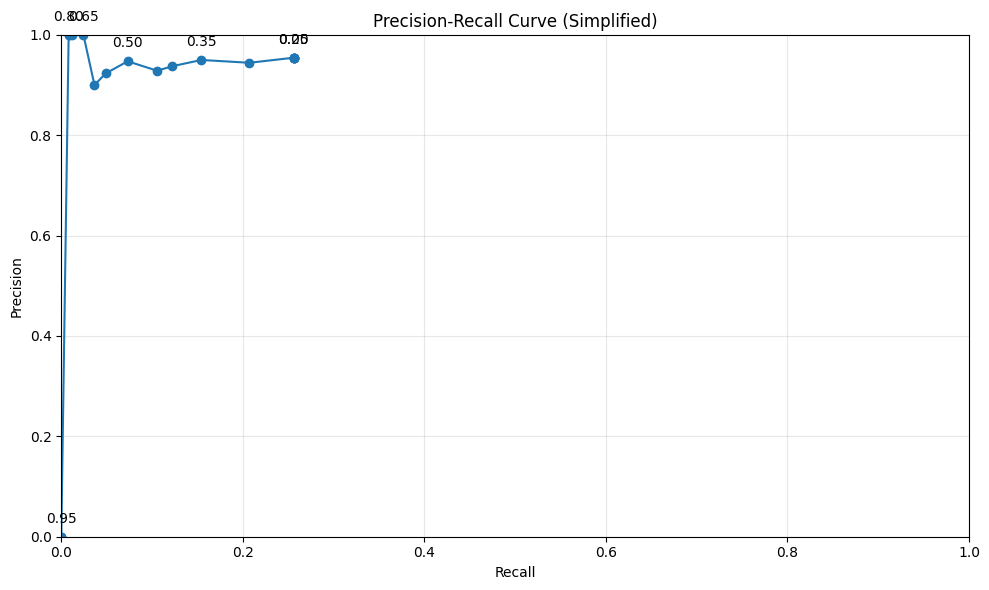


Plotting detections per image...


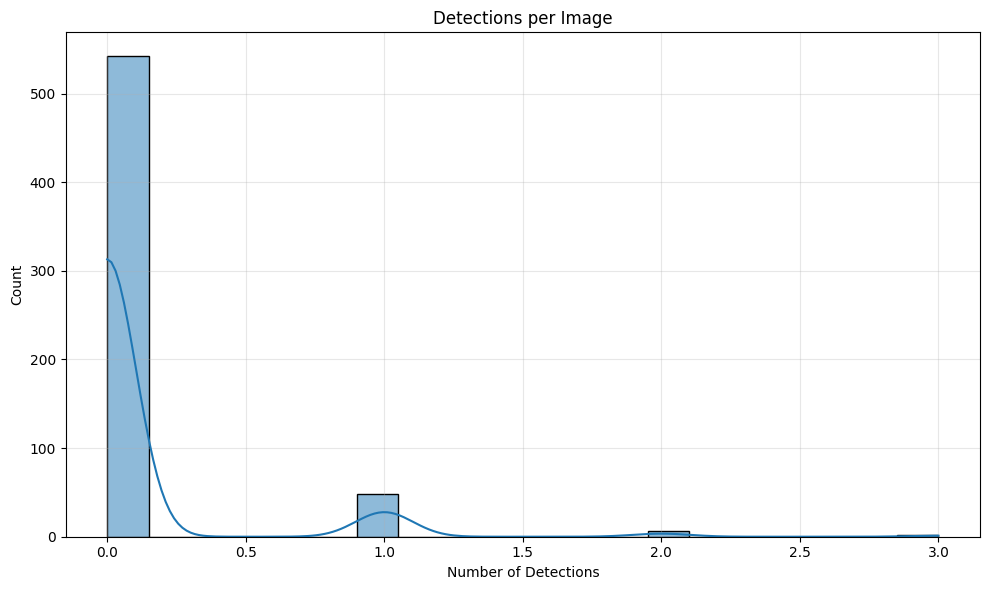


Detections per Image Statistics:
Average: 0.11
Maximum: 3
Minimum: 0


In [21]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
from collections import Counter, defaultdict


def plot_class_distribution(dataset):
    # Count ground truth and predictions by class
    gt_classes = []
    pred_classes = []

    # Get counts for each class
    for sample in dataset:
        # Ground truth
        if sample.has_field("ground_truth") and len(sample.ground_truth.detections) > 0:
            for det in sample.ground_truth.detections:
                gt_classes.append(det.label)

        # Predictions
        if sample.has_field("predictions") and len(sample.predictions.detections) > 0:
            for det in sample.predictions.detections:
                pred_classes.append(det.label)

    # Count occurrences
    gt_counts = Counter(gt_classes)
    pred_counts = Counter(pred_classes)

    # Get all unique classes
    all_classes = sorted(set(list(gt_counts.keys()) + list(pred_counts.keys())))

    # Create dataframe for plotting
    data = []
    for cls in all_classes:
        data.append({
            'Class': cls,
            'Count': gt_counts.get(cls, 0),
            'Type': 'Ground Truth'
        })
        data.append({
            'Class': cls,
            'Count': pred_counts.get(cls, 0),
            'Type': 'Prediction'
        })

    df = pd.DataFrame(data)

    # Plot
    plt.figure(figsize=(12, 6))
    sns.barplot(x='Class', y='Count', hue='Type', data=df)
    plt.title('Class Distribution: Ground Truth vs Predictions')
    plt.ylabel('Count')
    plt.xlabel('Class')
    plt.xticks(rotation=45)
    plt.legend(title='')
    plt.tight_layout()
    plt.savefig('class_distribution.png', dpi=300)
    plt.show()

    # Calculate and print recall by class
    print("\nSimple Recall by Class (Predictions/Ground Truth):")
    for cls in all_classes:
        gt_count = gt_counts.get(cls, 0)
        pred_count = pred_counts.get(cls, 0)
        if gt_count > 0:
            recall = pred_count / gt_count
            print(f"{cls}: {recall:.2f} ({pred_count}/{gt_count})")

def plot_confidence_distribution(dataset):
    # Extract confidence scores by class
    confidences = defaultdict(list)

    for sample in dataset:
        if sample.has_field("predictions") and len(sample.predictions.detections) > 0:
            for det in sample.predictions.detections:
                confidences[det.label].append(det.confidence)

    # Plot overall confidence distribution
    plt.figure(figsize=(12, 6))

    # Combine all confidences
    all_conf = []
    for cls, conf_list in confidences.items():
        all_conf.extend(conf_list)

    sns.histplot(all_conf, bins=20, kde=True)
    plt.title('Distribution of Confidence Scores')
    plt.xlabel('Confidence Score')
    plt.ylabel('Count')
    plt.axvline(x=0.25, color='r', linestyle='--', label='Threshold (0.25)')
    plt.legend()
    plt.tight_layout()
    plt.savefig('confidence_distribution.png', dpi=300)
    plt.show()

    # Plot confidence distributions by class
    plt.figure(figsize=(12, 6))
    for cls, conf_list in confidences.items():
        if len(conf_list) > 5:  # Only plot if we have enough data
            sns.kdeplot(conf_list, label=cls)

    plt.title('Confidence Distribution by Class')
    plt.xlabel('Confidence Score')
    plt.ylabel('Density')
    plt.axvline(x=0.25, color='r', linestyle='--', label='Threshold (0.25)')
    plt.legend()
    plt.tight_layout()
    plt.savefig('confidence_by_class.png', dpi=300)
    plt.show()

    # Print average confidence by class
    print("\nAverage Confidence by Class:")
    for cls, conf_list in confidences.items():
        if len(conf_list) > 0:
            avg_conf = sum(conf_list) / len(conf_list)
            print(f"{cls}: {avg_conf:.4f} (from {len(conf_list)} detections)")

def plot_precision_recall_curve(dataset):

    thresholds = np.arange(0.05, 1.0, 0.05)
    precisions = []
    recalls = []

    # Count total ground truth objects
    gt_count = 0
    for sample in dataset:
        if sample.has_field("ground_truth"):
            gt_count += len(sample.ground_truth.detections)

    # For each threshold, compute precision and recall
    for threshold in thresholds:
        # Count detections above threshold
        true_positives = 0
        false_positives = 0

        for sample in dataset:
            if not sample.has_field("predictions"):
                continue

            # Count detections above threshold
            for det in sample.predictions.detections:
                if det.confidence >= threshold:
                    # This is a simplification - not using IoU matching
                    # In a real evaluation, you'd use IoU to determine TP vs FP
                    if sample.has_field("ground_truth") and len(sample.ground_truth.detections) > 0:
                        true_positives += 1
                    else:
                        false_positives += 1

        # Calculate precision and recall
        precision = true_positives / (true_positives + false_positives) if (true_positives + false_positives) > 0 else 0
        recall = true_positives / gt_count if gt_count > 0 else 0

        precisions.append(precision)
        recalls.append(recall)

    # Plot precision-recall curve
    plt.figure(figsize=(10, 6))
    plt.plot(recalls, precisions, marker='o')
    plt.title('Precision-Recall Curve (Simplified)')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.grid(True, alpha=0.3)
    plt.xlim([0, 1])
    plt.ylim([0, 1])

    # Annotate thresholds
    for i, threshold in enumerate(thresholds):
        if i % 3 == 0:  # Add label every 3 points to avoid clutter
            plt.annotate(f"{threshold:.2f}",
                        (recalls[i], precisions[i]),
                        textcoords="offset points",
                        xytext=(0,10),
                        ha='center')

    plt.tight_layout()
    plt.savefig('precision_recall_curve.png', dpi=300)
    plt.show()

def plot_detections_per_image(dataset):
    det_counts = []

    for sample in dataset:
        if sample.has_field("predictions"):
            det_counts.append(len(sample.predictions.detections))

    plt.figure(figsize=(10, 6))
    sns.histplot(det_counts, bins=20, kde=True)
    plt.title('Detections per Image')
    plt.xlabel('Number of Detections')
    plt.ylabel('Count')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.savefig('detections_per_image.png', dpi=300)
    plt.show()

    # Print statistics
    print("\nDetections per Image Statistics:")
    print(f"Average: {sum(det_counts)/len(det_counts):.2f}")
    print(f"Maximum: {max(det_counts)}")
    print(f"Minimum: {min(det_counts)}")

# Run all visualizations
try:
    print("Plotting class distribution...")
    plot_class_distribution(dataset)
except Exception as e:
    print(f"Error plotting class distribution: {e}")

try:
    print("\nPlotting confidence distribution...")
    plot_confidence_distribution(dataset)
except Exception as e:
    print(f"Error plotting confidence distribution: {e}")

try:
    print("\nPlotting precision-recall curve...")
    plot_precision_recall_curve(dataset)
except Exception as e:
    print(f"Error plotting precision-recall curve: {e}")

try:
    print("\nPlotting detections per image...")
    plot_detections_per_image(dataset)
except Exception as e:
    print(f"Error plotting detections per image: {e}")